In [193]:
from JupyterImport import *
from plotly.subplots import make_subplots
import progressbar
from progressbar import progressbar as prog
from sys import stdout
import plotly.express as px
from src.DataStandardize.ExpSpecific.Aug20 import Fixes
import src.DatObject.Attributes.SquareEntropy as SE
import src.DatObject.Attributes.Transition as T
root_logger.setLevel(logging.WARNING)

In [190]:
save_graphs = False

In [175]:
# dats = get_dats(range(900, 964+1), progress=True, overwrite=False)
# dats = get_dats(range(990, 994+1), progress=True, overwrite=False)
# dats = get_dats([997, 992, 995, 996], progress=True, overwrite=False)

# dats = get_dats(range(998, 1011+1), progress = True, dattypes = {'transition', 'square entropy'})
dats = get_dats(range(1012, 1065+1), progress = True)
dats = [dat for dat in dats if dat.SquareEntropy is not None]
dats = [dat for dat in dats if hasattr(dat.SquareEntropy, 'dS')]

100% (54 of 54) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


In [176]:
## ONLY works for one set of datnums!! 
if dats[0].datnum == 1012:
    dTs = list()

    ## Weakly coupled for each HQPC multiplier
    dat_chunk1 = [dat for dat in dats if dat.datnum in range(1012, 1018)]
    dat_chunk2 = [dat for dat in dats if dat.datnum in range(1030, 1036)]
    dat_chunk3 = [dat for dat in dats if dat.datnum in range(1048, 1054)]
    dat_chunks = [dat_chunk1, dat_chunk2, dat_chunk3]

    ## Full set of dats for each HQPC multiplier
    all_ds = [[dat for dat in dats if dat.datnum in range(l, u)] for l, u in zip([1012, 1030, 1048], [1028+1, 1045+1, 1063+1])]

    base_thetas = list()
    hot_thetas = list()
    all_dTs = list()
    for ds in dat_chunks:
        ts = list()
        hot_ts = list()
        for dat in ds:
            x = dat.SquareEntropy.Processed.outputs.x
            dat_ts = list()
            for data in dat.SquareEntropy.Processed.outputs.averaged[0::2]:
                fit = T.transition_fits(x, data, func=T.i_sense)[0]
                dat_ts.append(fit.best_values['theta'])
            dat_hot_ts = list()
            for data in dat.SquareEntropy.Processed.outputs.averaged[1::2]:
                fit = T.transition_fits(x, data, func=T.i_sense)[0]
                dat_hot_ts.append(fit.best_values['theta'])
            amps.append(np.nanmean(dat_amps))
            ts.append(np.nanmean(dat_ts))
            hot_ts.append(np.nanmean(dat_hot_ts))
        base_thetas.append(np.nanmean(ts))
        hot_thetas.append(np.nanmean(hot_ts))    
    dTs = [ht - bt for ht, bt in zip(hot_thetas, base_thetas)]
    
    base_pars = dats[0].Transition.avg_fit.params
    
    all_amps = list()
    for ds, base_theta in zip(all_ds, base_thetas):
        amps = list()
        for dat in ds:
            x = dat.SquareEntropy.Processed.outputs.x
            dat_amps = list()  
            for data in dat.SquareEntropy.Processed.outputs.averaged[0::2]:
                pars = CU.edit_params(base_pars, 'theta', base_theta, vary=False)
                fit = T.transition_fits(x, data, func=T.i_sense_digamma)[0]
                dat_amps.append(fit.best_values['amp'])
            amps.append(np.nanmean(dat_amps))
        all_amps.append(amps)

    for ds, dT, amps in zip(all_ds, dTs, all_amps):
        for dat, amp in zip(ds, amps):
            Fixes._add_magy(dat)  # Adds temporary magy field to Other.magy
            dat.SquareEntropy.Processed.plot_info.show = SE.ShowPlots(info=True, raw=True, averaged=True, entropy=True)
            dat.SquareEntropy.Processed.inputs.dT = dT
            dat.SquareEntropy.Processed.inputs.transition_amplitude = amp
            dat.SquareEntropy.process()
            dat.SquareEntropy.ShowPlots.integrated = True

In [177]:
if dats[0].datnum != 1012:
    for dat in progressbar.progressbar(dats, redirect_stdout=False):
        Fixes._add_magy(dat)  # Adds temporary magy field to Other.magy
    #     dT = 8.7
        dat.SquareEntropy.Processed.plot_info.show = SE.ShowPlots(info=True, raw=True, averaged=True, entropy=True)
        dT = 8
        amp = dat.Transition.avg_fit.best_values.amp
        dat.SquareEntropy.Processed.inputs.dT = dT
        dat.SquareEntropy.Processed.inputs.transition_amplitude = amp
        dat.SquareEntropy.process()
        dat.SquareEntropy.ShowPlots.integrated = True
    

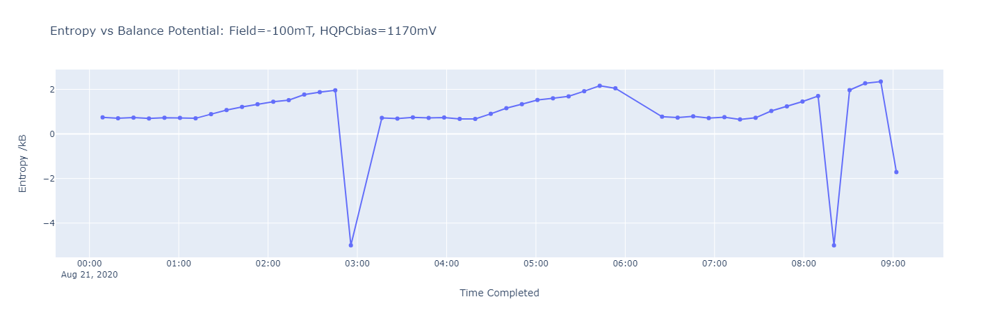

In [178]:
dss = [dat.SquareEntropy.Processed.outputs.entropy_fit.best_values.dS for dat in dats]
times = [pd.Timestamp(dat.Logs.time_completed) for dat in dats]

balance_potentials = [dat.AWG.AWs[1][0][1] for dat in dats]
hqpc_bias = dats[0].AWG.AWs[0][0][1]
fixed_field = dats[0].Other.magy.field
import plotly.express as px
fig = px.line(x=times, y=dss, labels={'x': 'Time Completed', 'y': 'Entropy /kB'}, hover_name=[f'Dat{dat.datnum}' for dat in dats],
              title=f'Entropy vs Balance Potential: Field={fixed_field:.0f}mT, HQPCbias={hqpc_bias:.0f}mV') #  ... Text=TC/0.001', text=[f'{bp:.1f}mV' for bp in balance_potentials]
fig.update_traces(mode='markers+lines')
fig.update_layout(hovermode='x unified')
if save_graphs: fig.write_html(export_path+f'Dats{dats[0].datnum}-{dats[-1].datnum}FitEntropyVsChannelBias.html')
fig

100% (49 of 49) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


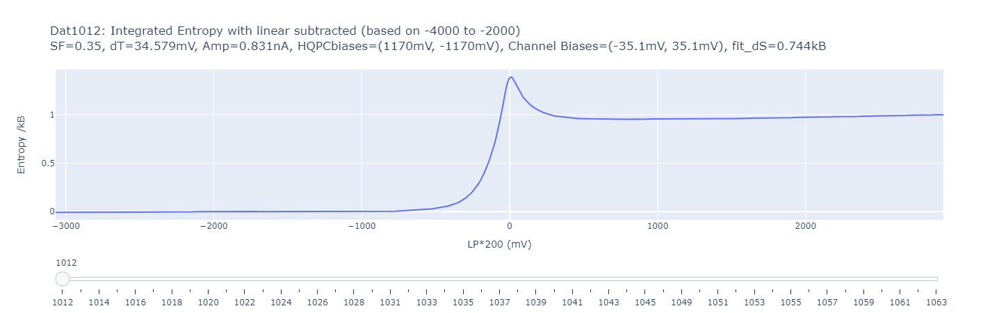

In [188]:
xs, datas, ids, titles = list(), list(), list(), list()
line = lm.models.LinearModel()
for dat in progressbar.progressbar(dats, redirect_stdout=False):
    stdout.flush()
    x = dat.SquareEntropy.Processed.outputs.x
    xs.append(x)
    ids.append(f'{dat.datnum}')
    
    dsp = dat.SquareEntropy.Processed
    ii = dsp.outputs.integrated_info
    text_info = f'SF={ii.sf:.2f}, dT={ii.dT:.3f}mV, Amp={ii.amp:.3f}nA, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), ' \
        f'Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV), fit_dS={dat.SquareEntropy.Processed.outputs.entropy_fit.best_values.dS:.3f}kB'
    titles.append(f'Dat{dat.datnum}: Integrated Entropy with linear subtracted (based on -4000 to -2000)<br>{text_info}')
    
    data = dat.SquareEntropy.Processed.outputs.integrated_entropy
    indexs = CU.get_data_index(x, [-2000, -1000])
    fit = line.fit(data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]])
    data = data-fit.eval(x=x)
    datas.append(data)
    
fig = PlU.get_figure(datas=datas, xs=xs, ids=ids, titles=titles, xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB')
if save_graphs: fig.write_html(f'Exports/Dats{dats[0].datnum}-{dats[-1].datnum}Integrated_vs_Channel_bias.html')
fig.show()

In [192]:
%matplotlib qt
fig, ax = plt.subplots(1,1)
for x, data in zip(xs[-16:], datas[-16:]):
    ax.plot(x, data)
plt.tight_layout();

In [ ]:
fig = px.line(datas[-16:], x=xs[-16:], name)

100% (49 of 49) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


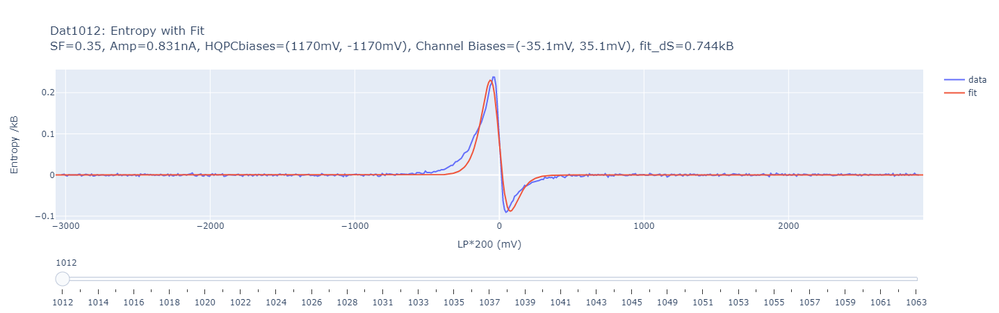

In [180]:
xs, datas, ids, titles = list(), list(), list(), list()
line = lm.models.LinearModel()
for dat in progressbar.progressbar(dats, redirect_stdout=False):
    stdout.flush()
    x = dat.SquareEntropy.Processed.outputs.x
    xs.append(x)
    ids.append(f'{dat.datnum}')
    
    dsp = dat.SquareEntropy.Processed
    ii = dsp.outputs.integrated_info
    text_info = f'SF={ii.sf:.2f}, Amp={ii.amp:.3f}nA, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), ' \
        f'Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV), fit_dS={dat.SquareEntropy.Processed.outputs.entropy_fit.best_values.dS:.3f}kB'
    titles.append(f'Dat{dat.datnum}: Entropy with Fit<br>{text_info}')
    
    data = np.array([dat.SquareEntropy.Processed.outputs.entropy_signal, dat.SquareEntropy.Processed.outputs.entropy_fit.eval_fit(x=x)])
#     indexs = CU.get_data_index(x, [-4000, -2000])
#     fit = line.fit(data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]])
#     data = data-fit.eval(x=x)
    datas.append(data)
    
fig = PlU.get_figure(datas=datas, xs=xs, ids=ids, titles=titles, labels=['data', 'fit'], xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB')
if save_graphs: fig.write_html(f'Exports/Dats{dats[0].datnum}-{dats[-1].datnum}Entropy with Fit.html')
fig.show()

100% (49 of 49) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


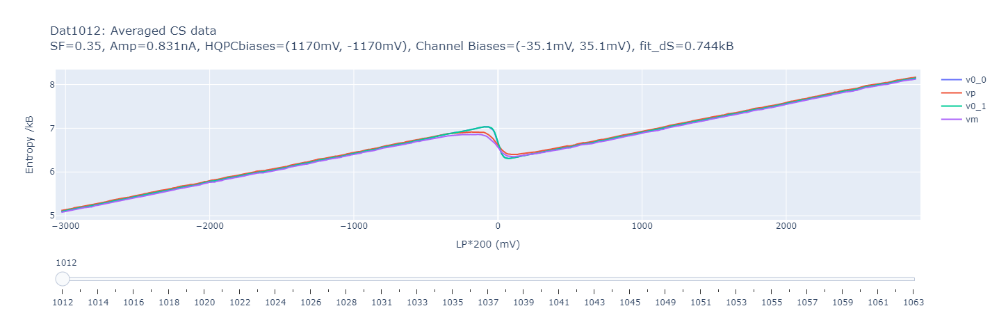

In [181]:
xs, datas, ids, titles = list(), list(), list(), list()
line = lm.models.LinearModel()
for dat in progressbar.progressbar(dats, redirect_stdout=False):
    stdout.flush()
    x = dat.SquareEntropy.Processed.outputs.x
    xs.append(x)
    ids.append(f'{dat.datnum}')
    
    dsp = dat.SquareEntropy.Processed
    ii = dsp.outputs.integrated_info
    text_info = f'SF={ii.sf:.2f}, Amp={ii.amp:.3f}nA, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), ' \
        f'Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV), fit_dS={dat.SquareEntropy.Processed.outputs.entropy_fit.best_values.dS:.3f}kB'
    titles.append(f'Dat{dat.datnum}: Averaged CS data<br>{text_info}')
    
    data = dat.SquareEntropy.Processed.outputs.averaged
#     indexs = CU.get_data_index(x, [-4000, -2000])
#     fit = line.fit(data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]])
#     data = data-fit.eval(x=x)
    datas.append(data)
    
fig = PlU.get_figure(datas=datas, xs=xs, ids=ids, titles=titles, labels=['v0_0', 'vp', 'v0_1', 'vm'], xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB')
fig.update_layout(hovermode = 'x unified')
if save_graphs: fig.write_html(f'Exports/Dats{dats[0].datnum}-{dats[-1].datnum}AveragedCS_vs_Channel_bias.html')
fig.show()

In [116]:
fit

In [187]:
for dat in dats:
#     print(dat.Transition.avg_fit.best_values.theta)
    thetas, gs = list(), list()
    values = list()
    for data in dat.SquareEntropy.Processed.outputs.averaged:
        x = dat.SquareEntropy.Processed.outputs.x
        fit = T.transition_fits(x=x, z=data, func=T.i_sense_digamma)[0]
        thetas.append(fit.best_values['theta'])
        gs.append(fit.best_values['g'])
        values.append(fit.best_values)
    print(f'\nDat{dat.datnum}: Thetas = {[round(t,2) for t in thetas]}, G = {[round(g,2) for g in gs]}')
#     print(f'\nDat{dat.datnum}: Thetas = {[round(t,2) for t in thetas]}')
#     print(values)
        


Dat1012: Thetas = [19.45, 22.67, 18.7, 25.24], G = [-3.45, 34.2, -2.9, 35.73]

Dat1013: Thetas = [24.05, 33.99, 24.57, 35.72], G = [-11.82, 17.65, -12.14, 19.37]

Dat1014: Thetas = [21.87, 41.01, 21.89, 43.6], G = [-6.32, 15.8, -6.61, 17.05]

Dat1015: Thetas = [22.13, 33.25, 20.49, 36.08], G = [-5.5, 26.48, -3.82, 27.87]

Dat1016: Thetas = [18.03, 0.11, 17.5, 13.82], G = [1.51, 54.59, 1.6, 54.41]

Dat1017: Thetas = [22.08, 27.14, 21.16, 28.0], G = [-0.3, 41.93, 0.88, 45.49]

Dat1018: Thetas = [24.16, 42.26, 23.68, 48.59], G = [-1.07, 27.29, -0.69, 24.17]

Dat1019: Thetas = [28.76, 47.92, 29.44, 51.72], G = [6.88, 37.79, 5.98, 37.7]

Dat1020: Thetas = [38.92, 69.67, 41.02, 76.11], G = [23.49, 45.36, 21.49, 41.25]

Dat1021: Thetas = [25.71, 17.86, 12.46, 27.29], G = [72.4, 140.83, 82.06, 141.17]

Dat1022: Thetas = [35.69, 7.39, 35.48, 75.57], G = [83.75, 162.61, 84.85, 108.89]

Dat1023: Thetas = [34.65, 63.4, 5.34, 68.58], G = [110.87, 155.95, 127.25, 153.95]

Dat1024: Thetas = [75.97, 

In [ ]:
dats = get_dats(range(238, 241+1))

In [ ]:
%matplotlib qt
fig, ax = plt.subplots(1,1)
for dat in dats:
    P.display_2d(dat.Data.x_array, dat.Data.y_array, dat.Data.Exp_cscurrent_2d, ax)
P.ax_setup(ax, '', dat.Logs.x_label, dat.Logs.y_label)